# Reddit

## Project Members:
- Omar Alkhayyat (2121118117)
- Ali Behbehani (2132131280)
- Essa Alansari (2121117232)


In [1]:
import requests
import praw
import pandas as pd
import sys
import os
import numpy as np
from pandas import datetime
import altair as alt

In [2]:
reddit = praw.Reddit(client_id='UJ7cIcf2yoZSNg',
                    client_secret='SC1SH-Jc3dqwhjeplg8sWGqRS-g'
                    ,password='abdullah-10' ,
                    user_agent='kuwaituniversity' ,
                    username='omaralkhayyat')

In [3]:
subriddet = reddit.subreddit('Popular')

In [4]:
authors = [x.author for x in subriddet.gilded()]

In [5]:
submission_dfs = []

for a in authors:
    # check if the csv file for the author name exists
    csv_file_name = "{}_submissions.csv".format(a.name)
    # the file exists, so lets load the csv as a dataframe
    if os.path.exists(csv_file_name):
        print("found {}, I will load the dataframe".format(csv_file_name))
        df = pd.read_csv(csv_file_name)
    else:
        print("did not find {}, loading from api".format(csv_file_name))
        
        #load submissions from reddit
        author_submissions = reddit.redditor(a.name).submissions

        # fetch the information for each submission of top 100 hot submissions
        sub_data = [
            {
                "title":x.title,
                "score":x.score,
                "num_comments":x.num_comments,
                "selftext":x.selftext,
                "ID":x.id,
                "Author":x.author.name,
                "Submission_Created":x.created_utc
            } for x in author_submissions.hot(limit=100)
        ]
        
    
        # create dataframe for the submissions of that author
        df = pd.DataFrame(sub_data)
                
        # store it, so we dont fetch it next time
        df.to_csv(csv_file_name)
    
    # add the author submission df to submission_dfs
    submission_dfs.append(df)

# loop ended, now combine all the dfs into a single df
subs_df = pd.concat(submission_dfs)

did not find shootabiscuit_submissions.csv, loading from api
did not find tilnewstuff_submissions.csv, loading from api
did not find Kodaco_submissions.csv, loading from api
did not find very_good_cat_submissions.csv, loading from api
did not find FixieDoo_submissions.csv, loading from api
did not find Chokotoff_submissions.csv, loading from api
did not find jstolfi_submissions.csv, loading from api
did not find Suicides_and_sundaes_submissions.csv, loading from api
did not find Secruoser_submissions.csv, loading from api
did not find Jeakjeak_submissions.csv, loading from api
did not find SwiggyBloodlust_submissions.csv, loading from api
found SwiggyBloodlust_submissions.csv, I will load the dataframe


UnicodeDecodeError: 'utf-8' codec can't decode byte 0xe9 in position 1587: invalid continuation byte

In [13]:
subs_df.head()

,Author,ID,Submission_Created,num_comments,score,selftext,title
0,jorshrod,7l56sb,1.513811e+09,362,4804,I was having an EMG test today and started tal...,How much bandwidth does the spinal cord have?
1,jorshrod,7l4b8z,1.513803e+09,11,1,[My IGS REP](https://www.reddit.com/r/IGSRep/c...,"[H] Wasteland 2: Director's Cut, Furi, Worms W..."
2,jorshrod,7l48mr,1.513802e+09,2,1,[FIRST PAGE](https://www.reddit.com/r/IGSRep/c...,Jorshrod's IGS Rep Page 2
3,jorshrod,7kmbct,1.513615e+09,8,1,[My IGS REP](https://www.reddit.com/r/IGSRep/c...,"[H] Wasteland 2: Directors Cut, BlazBlue: Chro..."
4,jorshrod,7j47a0,1.513018e+09,4,1,[My IGS REP](https://www.reddit.com/r/IGSRep/c...,"[H]Wasteland 2:Director's, Furi, H1Z1, Offworl..."


In [14]:
subs_df.Submission_Created = subs_df.Submission_Created.apply(datetime.fromtimestamp)

In [27]:
subs_df.to_csv("subs_df.csv")

In [5]:
cd_data = [
   {
       "name":x.name,
       "comment_karma":x.comment_karma,
       "post_karma":x.link_karma,
       "is_gold":x.is_gold,
       "is_mod":x.is_mod,
       "ID":x.id,
       "is employee":x.is_employee,
       "is_friend":x.is_friend,
       
       
   }
       
   for x in authors]

KeyboardInterrupt: 

In [18]:
cdf = pd.DataFrame(cd_data)

In [20]:
cdf.head()

,ID,comment_karma,is employee,is_friend,is_gold,is_mod,name,post_karma
0,4amx5,11338,False,False,True,False,jorshrod,9785
1,60siq,33855,False,False,True,False,attorneyriffic,903
2,mnal5,294,False,False,True,False,MasterBac,3699
3,11absx,891,False,False,True,False,AstralWave,10858
4,6k069,254,False,False,True,False,Chinguentes,8905


In [21]:
cdf.to_csv("cdf.csv")

In [26]:
cdf

,Created,ID,comment_karma,is employee,is_friend,is_gold,is_mod,name,post_karma
0,2011-04-12 05:28:43,53a1t,51482,False,False,True,False,Strid3r21,55980
1,2013-09-01 08:23:27,cyv1d,34593,False,False,True,False,Phineasfogg,34
2,2016-12-02 15:47:04,1397sf,10260,False,False,True,False,SoWhatDidIMiss,1114
3,2015-05-10 15:45:38,ne42w,32449,False,False,True,True,Baz-Ravish,8148
4,2008-02-13 18:59:48,3370f,20585,False,False,True,False,papercup,13
5,2013-07-06 00:35:06,c9xtv,5461,False,False,True,False,runedrune,2685
6,2016-07-16 09:10:54,zjlzm,1825,False,False,True,False,theboredlockpicker,3219
7,2017-07-11 01:44:50,6ot8gst,1788,False,False,True,True,antonfabijan,10074
8,2016-07-14 21:08:03,zi9rv,9126,False,False,True,False,JamieBGood1,501
9,2012-03-15 17:42:23,76fd9,59351,False,False,True,True,Pyrolytic,10678


In [22]:
final_df = cdf.merge(subs_df, how="outer", left_on="name", right_on="Author")

In [23]:
final_df

,ID_x,comment_karma,is employee,is_friend,is_gold,is_mod,name,post_karma,Author,ID_y,Submission_Created,num_comments,score,selftext,title
0,4amx5,11338,False,False,True,False,jorshrod,9785,jorshrod,7l56sb,2017-12-21 02:01:29,362.0,4804.0,I was having an EMG test today and started tal...,How much bandwidth does the spinal cord have?
1,4amx5,11338,False,False,True,False,jorshrod,9785,jorshrod,7l4b8z,2017-12-20 23:51:33,11.0,1.0,[My IGS REP](https://www.reddit.com/r/IGSRep/c...,"[H] Wasteland 2: Director's Cut, Furi, Worms W..."
2,4amx5,11338,False,False,True,False,jorshrod,9785,jorshrod,7l48mr,2017-12-20 23:41:24,2.0,1.0,[FIRST PAGE](https://www.reddit.com/r/IGSRep/c...,Jorshrod's IGS Rep Page 2
3,4amx5,11338,False,False,True,False,jorshrod,9785,jorshrod,7kmbct,2017-12-18 19:36:24,8.0,1.0,[My IGS REP](https://www.reddit.com/r/IGSRep/c...,"[H] Wasteland 2: Directors Cut, BlazBlue: Chro..."
4,4amx5,11338,False,False,True,False,jorshrod,9785,jorshrod,7j47a0,2017-12-11 21:38:34,4.0,1.0,[My IGS REP](https://www.reddit.com/r/IGSRep/c...,"[H]Wasteland 2:Director's, Furi, H1Z1, Offworl..."
5,4amx5,11338,False,False,True,False,jorshrod,9785,jorshrod,7i9nqu,2017-12-08 00:14:56,0.0,1.0,[My IGS REP](https://www.reddit.com/r/IGSRep/c...,"[H] Wasteland 2: Directors Cut, Furi, Sexy Bru..."
6,4amx5,11338,False,False,True,False,jorshrod,9785,jorshrod,7i8pny,2017-12-07 21:54:22,1.0,0.0,[removed],When does the season review come out? Did I mi...
7,4amx5,11338,False,False,True,False,jorshrod,9785,jorshrod,7hw45q,2017-12-06 08:58:53,3.0,29.0,I've been reflecting this week on the differen...,"34 weeks gone for #3, still doesn't feel real!"
8,4amx5,11338,False,False,True,False,jorshrod,9785,jorshrod,7hvmn2,2017-12-06 07:23:00,13.0,0.0,"I'm wanting to buy the Revan Reborn set, but o...",Best way to turn Cartel coins into Credits?
9,4amx5,11338,False,False,True,False,jorshrod,9785,jorshrod,7htsok,2017-12-06 02:27:33,12.0,1.0,[My IGS REP](https://www.reddit.com/r/IGSRep/c...,"[H] Wasteland 2: Director's Cut, Furi, H1Z1, O..."


In [24]:
final_df.to_csv("final_df.csv")

In [8]:
fdf = pd.read_csv("final_df.csv")

In [9]:
fdf

,Unnamed: 0,ID_x,comment_karma,is employee,is_friend,is_gold,is_mod,name,post_karma,Author,ID_y,Submission_Created,num_comments,score,selftext,title
0,0,4amx5,11338,False,False,True,False,jorshrod,9785,jorshrod,7l56sb,2017-12-21 02:01:29,362.0,4804.0,I was having an EMG test today and started tal...,How much bandwidth does the spinal cord have?
1,1,4amx5,11338,False,False,True,False,jorshrod,9785,jorshrod,7l4b8z,2017-12-20 23:51:33,11.0,1.0,[My IGS REP](https://www.reddit.com/r/IGSRep/c...,"[H] Wasteland 2: Director's Cut, Furi, Worms W..."
2,2,4amx5,11338,False,False,True,False,jorshrod,9785,jorshrod,7l48mr,2017-12-20 23:41:24,2.0,1.0,[FIRST PAGE](https://www.reddit.com/r/IGSRep/c...,Jorshrod's IGS Rep Page 2
3,3,4amx5,11338,False,False,True,False,jorshrod,9785,jorshrod,7kmbct,2017-12-18 19:36:24,8.0,1.0,[My IGS REP](https://www.reddit.com/r/IGSRep/c...,"[H] Wasteland 2: Directors Cut, BlazBlue: Chro..."
4,4,4amx5,11338,False,False,True,False,jorshrod,9785,jorshrod,7j47a0,2017-12-11 21:38:34,4.0,1.0,[My IGS REP](https://www.reddit.com/r/IGSRep/c...,"[H]Wasteland 2:Director's, Furi, H1Z1, Offworl..."
5,5,4amx5,11338,False,False,True,False,jorshrod,9785,jorshrod,7i9nqu,2017-12-08 00:14:56,0.0,1.0,[My IGS REP](https://www.reddit.com/r/IGSRep/c...,"[H] Wasteland 2: Directors Cut, Furi, Sexy Bru..."
6,6,4amx5,11338,False,False,True,False,jorshrod,9785,jorshrod,7i8pny,2017-12-07 21:54:22,1.0,0.0,[removed],When does the season review come out? Did I mi...
7,7,4amx5,11338,False,False,True,False,jorshrod,9785,jorshrod,7hw45q,2017-12-06 08:58:53,3.0,29.0,I've been reflecting this week on the differen...,"34 weeks gone for #3, still doesn't feel real!"
8,8,4amx5,11338,False,False,True,False,jorshrod,9785,jorshrod,7hvmn2,2017-12-06 07:23:00,13.0,0.0,"I'm wanting to buy the Revan Reborn set, but o...",Best way to turn Cartel coins into Credits?
9,9,4amx5,11338,False,False,True,False,jorshrod,9785,jorshrod,7htsok,2017-12-06 02:27:33,12.0,1.0,[My IGS REP](https://www.reddit.com/r/IGSRep/c...,"[H] Wasteland 2: Director's Cut, Furi, H1Z1, O..."


In [10]:
fdf["Total_score"]= fdf.groupby("name").transform(np.sum).score
fdf["Total_num_comments"]= fdf.groupby("name").transform(np.sum).num_comments

In [25]:
fdf.dtypes

Unnamed: 0              int64
ID_x                   object
comment_karma           int64
is employee              bool
is_friend                bool
is_gold                  bool
is_mod                   bool
name                   object
post_karma              int64
Author                 object
ID_y                   object
Submission_Created     object
num_comments          float64
score                 float64
selftext               object
title                  object
Total_score           float64
Total_num_comments    float64
Total_submission      float64
dtype: object

In [11]:
fdf

,Unnamed: 0,ID_x,comment_karma,is employee,is_friend,is_gold,is_mod,name,post_karma,Author,ID_y,Submission_Created,num_comments,score,selftext,title,Total_score,Total_num_comments
0,0,4amx5,11338,False,False,True,False,jorshrod,9785,jorshrod,7l56sb,2017-12-21 02:01:29,362.0,4804.0,I was having an EMG test today and started tal...,How much bandwidth does the spinal cord have?,9966.0,2503.0
1,1,4amx5,11338,False,False,True,False,jorshrod,9785,jorshrod,7l4b8z,2017-12-20 23:51:33,11.0,1.0,[My IGS REP](https://www.reddit.com/r/IGSRep/c...,"[H] Wasteland 2: Director's Cut, Furi, Worms W...",9966.0,2503.0
2,2,4amx5,11338,False,False,True,False,jorshrod,9785,jorshrod,7l48mr,2017-12-20 23:41:24,2.0,1.0,[FIRST PAGE](https://www.reddit.com/r/IGSRep/c...,Jorshrod's IGS Rep Page 2,9966.0,2503.0
3,3,4amx5,11338,False,False,True,False,jorshrod,9785,jorshrod,7kmbct,2017-12-18 19:36:24,8.0,1.0,[My IGS REP](https://www.reddit.com/r/IGSRep/c...,"[H] Wasteland 2: Directors Cut, BlazBlue: Chro...",9966.0,2503.0
4,4,4amx5,11338,False,False,True,False,jorshrod,9785,jorshrod,7j47a0,2017-12-11 21:38:34,4.0,1.0,[My IGS REP](https://www.reddit.com/r/IGSRep/c...,"[H]Wasteland 2:Director's, Furi, H1Z1, Offworl...",9966.0,2503.0
5,5,4amx5,11338,False,False,True,False,jorshrod,9785,jorshrod,7i9nqu,2017-12-08 00:14:56,0.0,1.0,[My IGS REP](https://www.reddit.com/r/IGSRep/c...,"[H] Wasteland 2: Directors Cut, Furi, Sexy Bru...",9966.0,2503.0
6,6,4amx5,11338,False,False,True,False,jorshrod,9785,jorshrod,7i8pny,2017-12-07 21:54:22,1.0,0.0,[removed],When does the season review come out? Did I mi...,9966.0,2503.0
7,7,4amx5,11338,False,False,True,False,jorshrod,9785,jorshrod,7hw45q,2017-12-06 08:58:53,3.0,29.0,I've been reflecting this week on the differen...,"34 weeks gone for #3, still doesn't feel real!",9966.0,2503.0
8,8,4amx5,11338,False,False,True,False,jorshrod,9785,jorshrod,7hvmn2,2017-12-06 07:23:00,13.0,0.0,"I'm wanting to buy the Revan Reborn set, but o...",Best way to turn Cartel coins into Credits?,9966.0,2503.0
9,9,4amx5,11338,False,False,True,False,jorshrod,9785,jorshrod,7htsok,2017-12-06 02:27:33,12.0,1.0,[My IGS REP](https://www.reddit.com/r/IGSRep/c...,"[H] Wasteland 2: Director's Cut, Furi, H1Z1, O...",9966.0,2503.0


In [26]:
fdf.Author.value_counts()

bwburke94               100
Max_Trollbot_           100
Unbelievabob            100
attorneyriffic          100
dibbiluncan             100
VideoGameJeff           100
sgthombre               100
MarbledNightmare        100
GeneralissimoFranco     100
thecricketnerd          100
GeekyMeerkat            100
jorshrod                100
mrmattolsen             100
BulTV                   100
GuitarCFD               100
dweezil22               100
flakingnapstich         100
captainmagictrousers    100
Woofers_MacBarkFloof    100
Egon_1                  100
bilde2910               100
headoverheals           100
CineFunk                100
DrJWilson               100
RamsesThePigeon         100
mickeyquicknumbers      100
lun471k                 100
zazzlekdazzle           100
Rekdon                  100
Bastiat                 100
bakonydraco             100
DoctorWhosOnFirst       100
KVMechelen              100
cjet79                  100
strained_brain          100
_UpstateNYer_       

In [12]:
pd.set_option('display.max_rows', 4999)

In [13]:
fdf

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


In [35]:
Test.max_rows = len(fdf)

In [126]:
test2 = fdf.sample(3000)

In [127]:
test2

,Unnamed: 0,ID_x,comment_karma,is employee,is_friend,is_gold,is_mod,name,post_karma,Author,ID_y,Submission_Created,num_comments,score,selftext,title,Total_score,Total_num_comments
29,29,4amx5,11338,False,False,True,False,jorshrod,9785,jorshrod,6ydwzh,2017-09-06 09:21:28,28.0,3.0,Wife and I are coming to an impasse on naming ...,Leftover and discarded names request (female),9966.0,2503.0
505,505,e1xb8,127100,False,False,True,True,Max_Trollbot_,6304,Max_Trollbot_,2zhyit,2015-03-18 22:01:39,1.0,1.0,NaN,"If they made everything ""free to pirates"" woul...",25287.0,1500.0
5018,5018,fxvfr,324627,False,False,True,True,ALLSTARTRIPOD,1021,ALLSTARTRIPOD,674t6z,2017-04-24 00:20:59,6.0,9.0,I have a key for Fallout 3 on XBL for anyone w...,[Offer] Fallout 3 (xbox one/360),11313.0,889.0
2774,2774,3xro2,27341,False,False,True,True,GeneralissimoFranco,6437,GeneralissimoFranco,4m4nb6,2016-06-02 04:09:31,2.0,16.0,NaN,Memorial Day Weekend Bargain Pickups (Dollar G...,3997.0,1018.0
1567,1567,3sch0,200909,False,False,True,True,bakonydraco,22200,bakonydraco,63em5n,2017-04-04 18:00:14,58.0,32.0,## [/r/CFB Trivia Tuesday!](http://imgur.com/m...,Trivia Tuesday,12123.0,6288.0
4497,4497,37c2y,28052,False,False,True,False,amheekin,8899,amheekin,3as19d,2015-06-23 04:22:25,3.0,6.0,NaN,The amount of emails my friend has not opened ...,21276.0,3158.0
2376,2376,rpo6p,3980,False,False,True,False,JonathanJK,1214,JonathanJK,7512d8,2017-10-08 13:54:03,2.0,10.0,NaN,I'd be surprised if she gets this reference.,1555.0,437.0
2428,2428,73x3a,105286,False,False,True,True,dweezil22,1796,dweezil22,64qtzv,2017-04-11 16:33:57,23.0,14.0,In the post-nerf Grasp and Clever Dragon world...,FYI: God Roll Waltz Available from FWC this week,2215.0,1246.0
3555,3555,3ekml,788878,False,False,True,True,captainmagictrousers,12934,captainmagictrousers,3dba7q,2015-07-15 01:59:07,2.0,6.0,"Try selling stuff to people with jobs, idiots.",Why do all these restaurants have kids' menus?...,22127.0,1061.0
694,694,10e2ef,55799,False,False,True,False,mrmattolsen,7222,mrmattolsen,70c1xk,2017-09-15 22:15:00,0.0,4.0,NaN,Wild sunset last night [S7],8851.0,1476.0


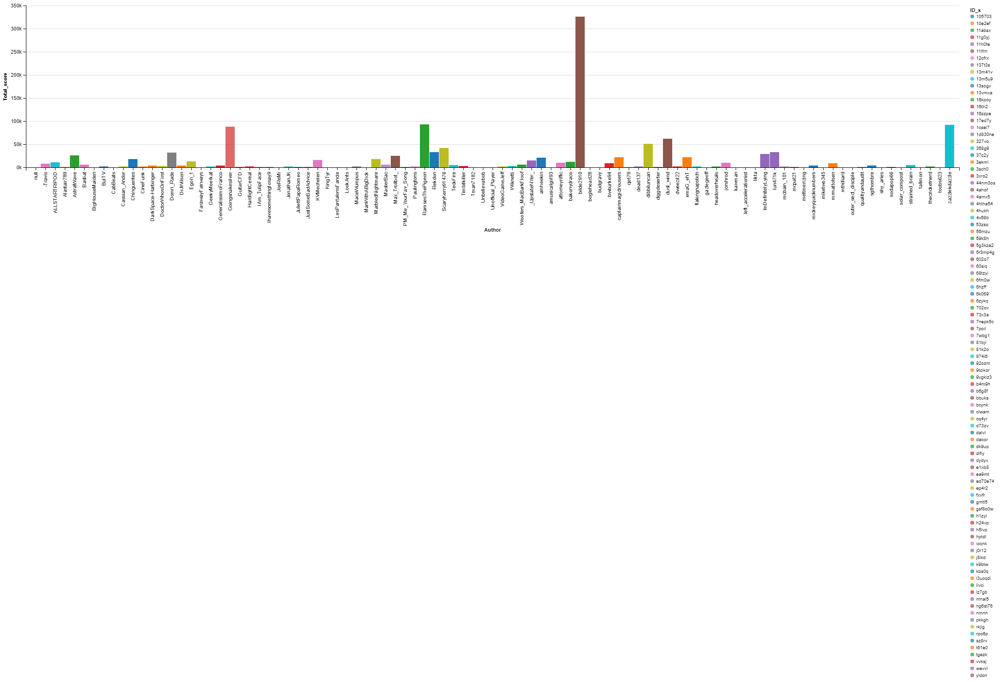

In [195]:
 alt.Chart(test2).mark_bar().encode(x= 'Author' , y= 'Total_score', color="ID_x")
    #how to sort it ?

In [196]:
alt.Chart(test2).mark_bar().encode(
    y=alt.Y('Author',sort=SortField (field='score', order='descending', op='sum'),
        axis=Axis(title='Authors')),
    x=alt.X('Total_score',
        axis=Axis(title='Total Score')))


NameError: name 'SortField' is not defined

In [103]:
Chart(fdf).mark_bar().encode(
        x=X('Author'), sort=SortField(field=('Author')),
        y='Total_score',
).configure_cell(width=1500).display

SyntaxError: unexpected EOF while parsing (<ipython-input-103-7eaa25697bf0>, line 4)

In [121]:
alt.Chart(test2).mark_bar().encode(alt.X('Total_score') , Order='descending'
                                   alt.Y('Author')
                                )

SyntaxError: invalid syntax (<ipython-input-121-c1a6219344b6>, line 2)

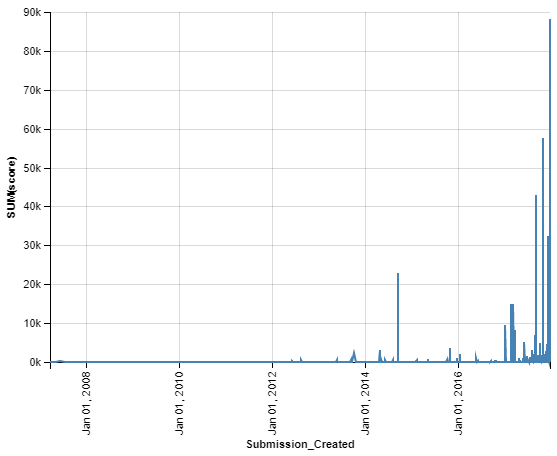

In [158]:
alt.Chart(test2).mark_line().encode(x='Submission_Created:T',timeUnit="month",
                                    y='sum(score)')


In [130]:
test_3=test2.Submission_Created.value_counts()

In [168]:
author_sample=test2.Author.sample(20)

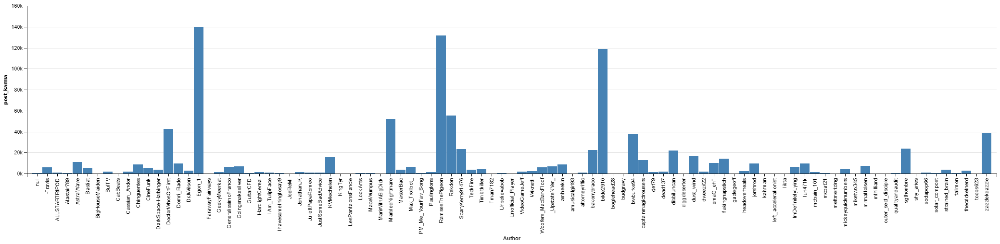

In [174]:
alt.Chart(test2).mark_bar().encode(x='Author',y='post_karma')

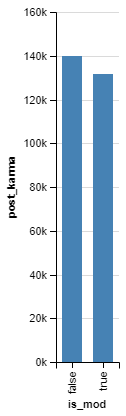

In [178]:
alt.Chart(test2).mark_bar().encode(x='is_mod',y='post_karma')

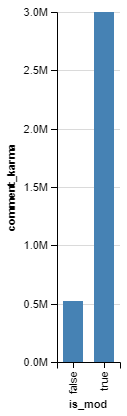

In [179]:
alt.Chart(test2).mark_bar().encode(x='is_mod',y='comment_karma')

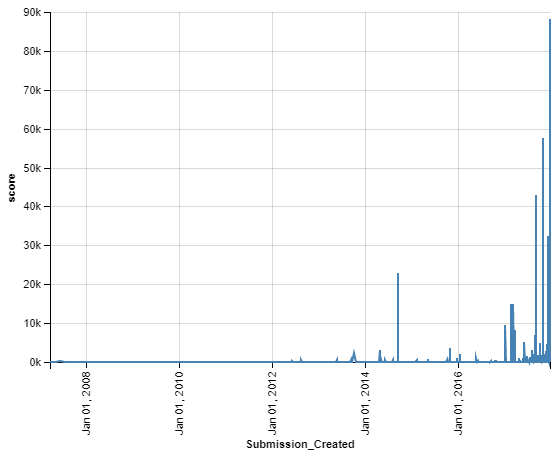

In [192]:
alt.Chart(test2).mark_line().encode(x='',y='score')